# Analysing change in performance due to age and experience

## Introduction

This project outlines what the effect of age and experience has on performance using player data gathered from NBA's official website. The data was originally scrapped by different authors and uploaded in kaggle. In this notebook we have combined some of these scrapped data to create one full dataset which will help us in visualizing the change in performance of a player over time. 
We start of the project by creating our dataset. This includes combining different datasets and creating new features from exisitng features. We then start our data analysis by plotting graphs for different groups of data by using techniques like data masking.
We finally conclude the project with a final statement based on our analysis and share the opportunities of future work in this field.

## Motivation

The main motivation behind creating this project was the movie - Moneyball. I had recently seen this movie and was inspired how statistics and data analysis was used to create a baseball team and how effective it can be in the field of sports. Buying and selling players is a huge part of the game for teams in NBA and other sports. A bad purchase or sell can often effect the teams championship run. When a team buys a young player they sometimes sell them way too early before giving them time to develop or sometimes too late. I wanted to help analyse this problem with the help of data visualization methods. One can see based on the age and player position how much time can be given to a player of particular age group before selling them.

## Contribution 

There have been many researchs done by people on NBA statisitcs but most of them perform the analysis on how player physicality has changed overtime? How different features are correlated with scoring more points or winning more matches? or predicting the odds of a particular team winning. Not many have analysed the data of player performance with age and how it can be utilised by teams to determine player contracts. This project mainly focuses on how the performance of players change with each year in the game. This might help teams in creating player contracts and utilize the players more efficiently.

Here are some examples of notebooks that have tried to analyse something similar:

NBA Drafting and Game analysis: https://www.kaggle.com/code/agilesifaka/historic-nba-drafting-game-and-player-analysis

NBA Height and Weight analysis: https://www.kaggle.com/code/justinas/nba-height-and-weight-analysis

NBA top scorrers analysis: https://www.kaggle.com/code/tsungchechiang/nba-top-scorers-1996-2021-animated-bubble-chart

## Methods

There are several different methods involved in this notebook. These methods will be explainedas we go through the notebook.

### Importing the dataset and required libraries

We start by importing the basic libraries like pandas and matplotlib. We also import the required datasets and then give a preview of the dataset using the `head()` function in pandas

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import data_mngt_vis as dv
import kaleido

In [2]:
common_player_info = pd.read_csv('common_player_info.csv')
common_player_info.head()

,person_id,first_name,last_name,display_first_last,display_last_comma_first,display_fi_last,player_slug,birthdate,school,country,...,playercode,from_year,to_year,dleague_flag,nba_flag,games_played_flag,draft_year,draft_round,draft_number,greatest_75_flag
0,76001,Alaa,Abdelnaby,Alaa Abdelnaby,"Abdelnaby, Alaa",A. Abdelnaby,alaa-abdelnaby,1968-06-24 00:00:00,Duke,USA,...,HISTADD_alaa_abdelnaby,1990.0,1994.0,N,Y,Y,1990,1,25,N
1,76003,Kareem,Abdul-Jabbar,Kareem Abdul-Jabbar,"Abdul-Jabbar, Kareem",K. Abdul-Jabbar,kareem-abdul-jabbar,1947-04-16 00:00:00,UCLA,USA,...,HISTADD_kareem_abdul-jabbar,1969.0,1988.0,N,Y,Y,1969,1,1,Y
2,1505,Tariq,Abdul-Wahad,Tariq Abdul-Wahad,"Abdul-Wahad, Tariq",T. Abdul-Wahad,tariq-abdul-wahad,1974-11-03 00:00:00,San Jose State,France,...,tariq_abdul-wahad,1997.0,2003.0,N,Y,Y,1997,1,11,N
3,949,Shareef,Abdur-Rahim,Shareef Abdur-Rahim,"Abdur-Rahim, Shareef",S. Abdur-Rahim,shareef-abdur-rahim,1976-12-11 00:00:00,California,USA,...,shareef_abdur-rahim,1996.0,2007.0,N,Y,Y,1996,1,3,N
4,76005,Tom,Abernethy,Tom Abernethy,"Abernethy, Tom",T. Abernethy,tom-abernethy,1954-05-06 00:00:00,Indiana,USA,...,HISTADD_tom_abernethy,1976.0,1980.0,N,Y,Y,1976,3,43,N


In [3]:
player_season_info = pd.read_csv('all_seasons.csv')
player_season_info.head()

,Unnamed: 0,player_name,team_abbreviation,age,player_height,player_weight,college,country,draft_year,draft_round,...,pts,reb,ast,net_rating,oreb_pct,dreb_pct,usg_pct,ts_pct,ast_pct,season
0,0,Randy Livingston,HOU,22.0,193.04,94.800728,Louisiana State,USA,1996,2,...,3.9,1.5,2.4,0.3,0.042,0.071,0.169,0.487,0.248,1996-97
1,1,Gaylon Nickerson,WAS,28.0,190.50,86.182480,Northwestern Oklahoma,USA,1994,2,...,3.8,1.3,0.3,8.9,0.030,0.111,0.174,0.497,0.043,1996-97
2,2,George Lynch,VAN,26.0,203.20,103.418976,North Carolina,USA,1993,1,...,8.3,6.4,1.9,-8.2,0.106,0.185,0.175,0.512,0.125,1996-97
3,3,George McCloud,LAL,30.0,203.20,102.058200,Florida State,USA,1989,1,...,10.2,2.8,1.7,-2.7,0.027,0.111,0.206,0.527,0.125,1996-97
4,4,George Zidek,DEN,23.0,213.36,119.748288,UCLA,USA,1995,1,...,2.8,1.7,0.3,-14.1,0.102,0.169,0.195,0.500,0.064,1996-97


### Combining Dataframes

The `common_player_info` dataset contains information about all the players in the NBA. It includes the players age, height, weight, country and many other things. It gives an overall view of a particular player in each row.

The `player_season_info` dataset gives the information about players every season. Each row gives the player statistics like points made, rebounds, assist percentage, etc. for a particular season.

In further analysis we require, the player's position so that we can group the data and analyse how different positions have different insights. Here we add the `position feature` from the `common_player_info` dataset to the `player_season_info` dataset

In [4]:
player_season_info['position'] = 0

for i in range(len(player_season_info)):
    for j in range(len(common_player_info)):
        if common_player_info.iloc[j,3] == player_season_info.iloc[i,1]:
            player_season_info.loc[i,'position'] = common_player_info.iloc[j,15]
            break

In [5]:
player_season_info.head()

,Unnamed: 0,player_name,team_abbreviation,age,player_height,player_weight,college,country,draft_year,draft_round,...,reb,ast,net_rating,oreb_pct,dreb_pct,usg_pct,ts_pct,ast_pct,season,position
0,0,Randy Livingston,HOU,22.0,193.04,94.800728,Louisiana State,USA,1996,2,...,1.5,2.4,0.3,0.042,0.071,0.169,0.487,0.248,1996-97,Guard
1,1,Gaylon Nickerson,WAS,28.0,190.50,86.182480,Northwestern Oklahoma,USA,1994,2,...,1.3,0.3,8.9,0.030,0.111,0.174,0.497,0.043,1996-97,Guard
2,2,George Lynch,VAN,26.0,203.20,103.418976,North Carolina,USA,1993,1,...,6.4,1.9,-8.2,0.106,0.185,0.175,0.512,0.125,1996-97,Forward
3,3,George McCloud,LAL,30.0,203.20,102.058200,Florida State,USA,1989,1,...,2.8,1.7,-2.7,0.027,0.111,0.206,0.527,0.125,1996-97,Forward
4,4,George Zidek,DEN,23.0,213.36,119.748288,UCLA,USA,1995,1,...,1.7,0.3,-14.1,0.102,0.169,0.195,0.500,0.064,1996-97,Center


### Different positions present in our dataset

We have added the position dataset into the `player_season_info` dataframe. Lets see how those values are spread out in the dataset. We use the Matplotlib library for preparing a histogram. We ue the histogram in particular because it will give us a better visualization of the count of each position present in the dataset. Before visualizing though we have to replace the null values present in that column. We first replace those values with 'NA' and then plot a histogram

In [6]:
player_season_info.fillna(0, inplace=True)
player_season_info['position'] = player_season_info['position'].replace(0,'NA')
pd.unique(player_season_info['position'])


array(['Guard', 'Forward', 'Center', 'Forward-Guard', 'NA',
       'Center-Forward', 'Guard-Forward', 'Forward-Center'], dtype=object)

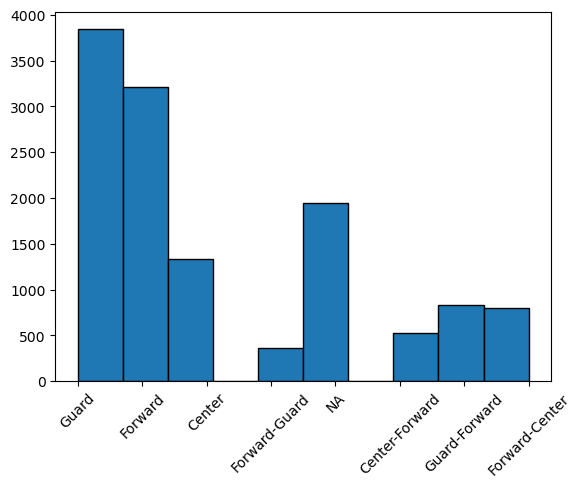

In [7]:
plt.hist(player_season_info['position'], edgecolor='black')
plt.xticks(rotation=45)
plt.show()

As we can see from the histogram, there are 2 types of positions core positions like "Guard", "Forward" and "Center" and a sort of hybrid position which is a mix of 2 different positions like "Forward-Guard", "Center-Forward","Guard-Forward" and "Forward-Center". The volume of core positions are high compared to hybrid positions. For the sake of analysis we will group similar positions together. Our groups will look something like this:

1. Guard   : Guard + Guard-Forward
2. Forward : Forward + Forward-Guard + Forward-Center
3. Center  : Center + Center-Forward

There are around 2000 players for which the position values could not be fetched. Currently, we wont be including those players in our Analysis.

### Performing Minor Transformations

Now that we have player positions to group or data, we need some new fatures to represent the performance change of players more precisely. We have data about the number of rebounds, points scored, assists, games played among many others. As we want to see the difference in performance, we will create 2 new features which will give a better picture of the difference: Change in performance compared to first season, change in performance compared to previous year. These features especially comparing the performance to first season will help us scale the values much better and also help us create a more readable graph.

Although having these features in our graph have certain limitations as well. One of these limitations is, we wont be able to differentiate between the performance of a top class player and an average player. For example, a top class player might have scored a 100 assists in the first season and 110 assists in the second season but, in this feature it will only be counted as 10 while an average player who had 30 assists in the first season and 50 assists in the second season wil have the value 20 in this feature. These graphs will not help us differentiate between a top class player and an average player, but will help us visualize how a players performance in general changes over the season.

Here we run the `dataframe_manipulation()` function imported from the data_management_visualizaition module. This function first adds empty features in our dataframe and then loops over the length of the dataframe to calculate the different performance difference calculations and then assigns them to the appropriate columns.

In [8]:
player_season_info = dv.dataframe_manipulation(player_season_info)

### Interactive plots using data masking and lambda functions

The data for starting our visualization is ready. We now use the `grouped_lineplot()` function from the data_management_visualization module. 

The first main objective of this function is make groups from the data based on player position. We pass a list of positions to the function that it uses in its query to create a mask and then based on that mask creates a new dataframe. 

Now that we have a dataframe containing player statistics for all players belonging to certain positions we move on the next step. In this step we use a lambda function to act as a counter or a flag for our legends. Since we have 1000s of lines in our plot we dont want a legend for each line, we only want legends representing a group of lines.
This lambda function helps us achieve that by acting as a counter and then passing its value to the show_legend attribute of our lines. This way we only have 1 legend for each group.

Now once the lambda function is setup, the function runs a loop that iterates through each row of the masked data. Here we check another condition before adding any graph objects to our plot; the age. While calling the function we pass the upper and lower limits of age we want to analyze as paramters of the function. All players falling under this condition are picked for visualization. 

In each loop of the function, we add 4 lines to the plot each representing 4 different metrics of performance. These metrics are: Rebounds, Points, Assists and Games Played (GP). A form of data masking is used to pass the vector values of X and Y in the graph. Each line is then given a group name based on the metric it represents. The `showlegend` attribute here helps to determine if we want to show the legend for this graph object or not. Based on the counter which is only active in the first run of the loop, the attribute is set to true or false.

Once the loop ends, the function creates a plotly `graphObject` and returns it to our main notebook and using the `fig.show()` we can visualize the full plot.

The graph plots 4 different kinds of performance metric rebound, points, assists and game played. These metrics are mentioned in the label as well. As this is an interactive graph, the user can click on the respective labels and that particular group will be hidden. The graph is automatically scaled as well, for example when you just keep the 'change in rebounds' metric in the graph the scale is between -4 to 4 but when you change it to points the scale is changed to -20 to 20. This wat we can use 1 single graph to compare different groups of data.

## Analysis for players above 26

The analysis is divided into 2 age groups, 1 below 20 and the other above 26. According to general assumption, young players will have more time to reach their peak performance while people joining the sport at the age of 26 will relatively have less time or have already reached their peak.

We further divide the analysis into positions. Guard, Forward and Center. While doing the analysis the user has to select the metric which is under analysis to get a better perception.

### 1. Player Age: 26 Position: Guard

In [16]:
fig = go.Figure()
dv.grouped_lineplot(player_season_info, ['Guard','Guard_Forward'], 26, 45 ,fig)
fig.update_layout(width=1600, height=500)
#fig.show() # Interactive plots
fig.show('svg')

1. Games Played: 
    As seen from the graph, majority of the playes might play the most games in the first or the second season after which the number of games played is decreased.

2. Assists:
    In case of assists, most players tend to perform almost the same if not worse over the years. The change in assists compared to the first season, is around +4 to -8. The peak number of assists might be in the 3rd or 4th season for most players.
    
3. Points:
    For most of the players aged 26 and above, first or second season is wehn they might score the most points after which the number point scored each season slowly declines.
    
4. Rebound: 
    In case of rebounds as well, the change in performance is between -4 to +4. With most rebounds coming from a player at his second or third season.

### 2. Player Age: 26 Position: Forward 

In [17]:
fig = go.Figure()
dv.grouped_lineplot(player_season_info, ['Guard','Guard_Forward'], 26, 45 ,fig)
fig.update_layout(width=1600, height=500)
#fig.show() # Interactive plots
fig.show('svg')

1. Games Played: For a forward player with age more than 26, mostly the number of games played each season will be highest in the first or second season. There is a lot of fluctuationg in the number of games played after the second season but most of them either play the same number of games or less.

2. Assists: No clear trend can be seen in the case of assists. The change in assists is between +3 and -3. There are players who have reached their peak performance after the 3rd or 4th season and there are players who performed their worst after the same time period.

3. Points: A clear trend can be seen in case of points. Most of the players slowly score less and less points after the second or third season. There are a few outliers who have scored the most points in their 4th season.

4. Rebounds: In case of rebounds, there is a slight downfall after the third season. The maximum improvement in performance is +3 but the maximum decreament in performance is -10. 

### 3. Player Age: 26 Position: Center 

In [18]:
fig = go.Figure()
dv.grouped_lineplot(player_season_info, ['Guard','Guard_Forward'], 26, 45 ,fig)
fig.update_layout(width=1600, height=500)
#fig.show() # Interactive plots
fig.show('svg')

1. Games Played: The most number of games played for most of the centers starting their career aged 26 and above is the second season after which it starts decreasing. Compared to other positions, this position has the most decline in the number of games played.

2. Assists: In case of assists as well most of the players have had their peak performance in the 2nd seasos after which it starts declining. 

3. Points: In case of points as well most of the peak points for all the players were in the 2nd season after which it starts declining.

4. Rebound: Similarly in rebound stats as well the peak perfomance for most players were in the 2nd season after which it starts declining.

# Conclusion 1.1:
## Insight for analysis done on players starting their career after 26

The most performance decline for any position is Center. The peak performance of a center player that started their career at 26 is during their second season in NBA in most cases. It decreases in cases of all performance metrics lke assists, points scored and rebounds. Forwards on the other hand have shown a bit more consistency compared to centers and guards with reaching their peak performance by the thrid or fourth season and then declining slowly. Guards also show a slow decline with year in the points scored. Most of the players aged 26 and above reach their peak performance in the 2nd or 3rd season if not declined already.


_A team is looking to buy a prospective player but he has never played in the league before and he is aged 27. What should be kept in mind in this case?_

-> Most of the centers starting at the age of 26 an above historically have achieved their peak performance in the second season or atmost at the 4th season if not failed already. If bought, the franchise should not keep the player for more than 4 seasons as the chances of performance improving after that. 
If the position is guard or forward, maybe the franchise can keep him till the 5th season.
The best stratergy would be to sign short term contracts and keep on renewing them until the 4th or 5th season.

## Analysis for players below 20 

These are the young prospects of the league who can go on to dominate the game with experience. Compared to the players aged 26 and above, these guys should have more time to reach the peak performance. 

Similar to the first group we divide the players into 3 groups based on position and we will conduct seperate analysis on each.

In [19]:
fig = go.Figure()
dv.grouped_lineplot(player_season_info, ['Guard','Guard_Forward'], 16, 21 ,fig)
fig.update_layout(width=1600, height=500)
#fig.show() # Interactive plots
fig.show('svg')

1. Games played: As expected, the number of seasons players played is a comparitively more than the previous age group. There is a lot of variation in the games played with some always being in the positive side of the graph while some directly falling from the second season itself.

2. Assists: Compared to the other age group, here the positive scale(+10) is larger than the negative scale(-4). The peak performance of most players seem to be during the 6th and 7th season after which it slowly comes back to normal.

3. Points: Here we cant definetly say if when most of the players achieve the peak performance but we can notice one thing that most of the players who do not do well in their second seacond season tend to underperform rest of their career. Most of the players seem to be increasing their performance till the 4th or 5th season after which the graph becomes a bit unclear.

4. Rebounds: In terms of rebound there is not much change in terms of performance. The graph is unclear in terms of when player performance might have peaked, but still the peak is not that different from the initial performance. Most of the players stay more or less consistent with ther rebound scores. 

In [20]:
fig = go.Figure()
dv.grouped_lineplot(player_season_info, ['Forward','Forward-Guard','Forward-Center'], 16, 21 ,fig)
fig.update_layout(width=1600, height=500)
#fig.show() # Interactive plots
fig.show('svg')

1. Games Played: Here as well, the number of seasons played by most of the players is more as compared to the other age group. But the graph has a lot of variations so we cant say how the number of games played changes with season.

2. Assists: We can see that most players maximised their assists during the 6th and 7th season. We can also see that this score difference is not much and can be considered as consistent.

3. Points: In terms of points most of the players have shown their best performance during the 5th and 6th season. 

4. Rebound: In terms of rebound, there is alot of variation present among the players. We cant see clearly where the maximum rebounds are there for most of the player. 

In [21]:
fig = go.Figure()
dv.grouped_lineplot(player_season_info, ['Center','Center-Forward'], 16, 21 ,fig)
fig.update_layout(width=1600, height=500)
#fig.show() # Interactive plots
fig.show('svg')

1. Games Played: In terms of games played, for centers they might get to play the most games in the 4th or 5th season after which there is a decline observed.

2. Assists: In terms of assists, 5th and 6th season can be considered as the season where the player has the most assists.

3. Points: In this case, there have been vert few cases of decline compared to the initial season. Most of the players achieved their maximum performance during the 6th and 7th season.

4. Rebound: Similarly for points, the maximum was achieved during the 6th and 7th season. There is a lot of variation in this graph compared to assists and points.

# Conclusion 1.2:
## Insights for analysis done on players starting their career before 21

Compared to the other age group, players starting before 21 have a lot of variations in the games they play every season. Although this is to be expected but as seen from the graphs they have more room to improve than decline as compared to the other age group. In most of the cases the maximum performance a player has achieved is during the 6th or 7th season if not declined already as compared to the 4th and 5th season for the other age group.


_A team is looking to buy a prospective player but he has never played in the league before and he is aged 19. What should be kept in mind in this case?_</br>
-> Players starting at an age of 19 can have high room for growth with experience. In most of the posisitions it takes around 6-7 seasons for the player to perform at the max before declining and in some situations 4-5 seasons. If the player is showing growth and promise, the franchise can ofer him a contract keeping in mind that he might perform the max between their 5th and 7th seasons of the campaign. 

These insights dont mean that all players might perform the best during the said part of their career but, if given the slow growth of a player ther is a high chance of him being at his max during the said part. A franchise can make use of this information for buying and selling the players. A franchise can sell the player at his maximum and earn some profit and start looking for new prospects who are just before their prime. Obviously, there are other circumstances which can effect a players performance which can cause abrupt change in their performance.